In [63]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import imghdr
import json
import tensorflow as tf
import os
import cv2
from PIL import Image

In [5]:
xray_dataset_path = "/kaggle/input/arcade-x-ray-angiography-images/submission"
angiography_dataset_path = "/kaggle/input/coronary-angiography-print"

In [6]:
os.listdir(xray_dataset_path)

['stenosis', 'syntax']

In [7]:
os.listdir(angiography_dataset_path)

['50 (22).jpg',
 '21 (33).jpg',
 '37 (24).jpg',
 '20 (14).jpg',
 '16 (42).jpg',
 '5 (6).jpg',
 '46 (16).jpg',
 '28 (25).jpg',
 '12 (30).jpg',
 '28 (28).jpg',
 '4 (26).jpg',
 '24 (36).jpg',
 '17 (24).jpg',
 '4 (21).jpg',
 '26 (16).jpg',
 '24 (19).jpg',
 '19 (38).jpg',
 '51 (33).jpg',
 '13 (6).jpg',
 '48 (40).jpg',
 '20 (39).jpg',
 '10 (8).jpg',
 '23 (8).jpg',
 '30 (31).jpg',
 '33 (45).jpg',
 '32 (32).jpg',
 '8 (7).jpg',
 '13 (34).jpg',
 '29 (32).jpg',
 '41 (4).jpg',
 '47 (21).jpg',
 '2 (26).jpg',
 '37 (42).jpg',
 '34 (27).jpg',
 '45 (13).jpg',
 '42 (9).jpg',
 '23 (29).jpg',
 '41 (10).jpg',
 '43 (11).jpg',
 '34 (35).jpg',
 '28 (39).jpg',
 '36 (10).jpg',
 '31 (40).jpg',
 '46 (11).jpg',
 '14 (15).jpg',
 '10 (35).jpg',
 '36 (40).jpg',
 '14 (2).jpg',
 '18 (1).jpg',
 '35 (34).jpg',
 '9 (16).jpg',
 '32 (20).jpg',
 '28 (38).jpg',
 '3 (78).jpg',
 '10 (37).jpg',
 '45 (2).jpg',
 '1 (18).jpg',
 '33 (33).jpg',
 '5 (18).jpg',
 '36 (38).jpg',
 '48 (27).jpg',
 '1 (4).jpg',
 '30 (22).jpg',
 '28 (12).jpg

In [12]:
image_exts = ['jpg','jpeg','png']

In [21]:
def process_images_in_folder(folder_path):
    for root, _, files in os.walk(folder_path):  
        for file in files:
            image_path = os.path.join(root, file)
            try:
                img = cv2.imread(image_path)
                tip = imghdr.what(image_path)
                if tip not in image_exts:
                    print(f"Image not in ext list: {image_path}")
                    os.remove(image_path)  
            except Exception as e:
                print(f"Issue with image: {image_path} - {e}")

In [23]:
for category in ['stenosis', 'syntax']:
    category_path = os.path.join(xray_dataset_path, category)
    
    for split in ['test', 'train', 'val']:
        images_folder = os.path.join(category_path, split, 'images')
        print(f"Processing images in: {images_folder}")
        process_images_in_folder(images_folder)

Processing images in: /kaggle/input/arcade-x-ray-angiography-images/submission/stenosis/test/images
Processing images in: /kaggle/input/arcade-x-ray-angiography-images/submission/stenosis/train/images
Processing images in: /kaggle/input/arcade-x-ray-angiography-images/submission/stenosis/val/images
Processing images in: /kaggle/input/arcade-x-ray-angiography-images/submission/syntax/test/images
Processing images in: /kaggle/input/arcade-x-ray-angiography-images/submission/syntax/train/images
Processing images in: /kaggle/input/arcade-x-ray-angiography-images/submission/syntax/val/images


In [24]:
for image in os.listdir(angiography_dataset_path):
    image_path = os.path.join(angiography_dataset_path, image)
    try:
        img = cv2.imread(image_path)
        tip = imghdr.what(image_path)
        if tip not in image_exts:
            print(f"Image not in ext list: {image_path}")
            os.remove(image_path) 
    except Exception as e:
        print(f"Issue with image: {image_path}")

In [25]:
data = tf.keras.utils.image_dataset_from_directory('/kaggle/input/arcade-x-ray-angiography-images/submission')

Found 3000 files belonging to 2 classes.


In [27]:
image_paths = [os.path.join(angiography_dataset_path, fname) for fname in os.listdir(angiography_dataset_path) if fname.endswith(('png', 'jpg', 'jpeg'))]

In [28]:
image_ds = tf.data.Dataset.from_tensor_slices(image_paths)

In [34]:
def plot_images(image_paths, num_images=9):
    fig, axes = plt.subplots(3, 3, figsize=(10, 10))
    axes = axes.flatten()
    
    for i in range(num_images):
        image = tf.io.read_file(image_paths[i])
        image = tf.image.decode_jpeg(image, channels=3)
        image = tf.image.resize(image, (224, 224)) / 255.0
        axes[i].imshow(image)
        axes[i].axis('off')
        
    plt.show()

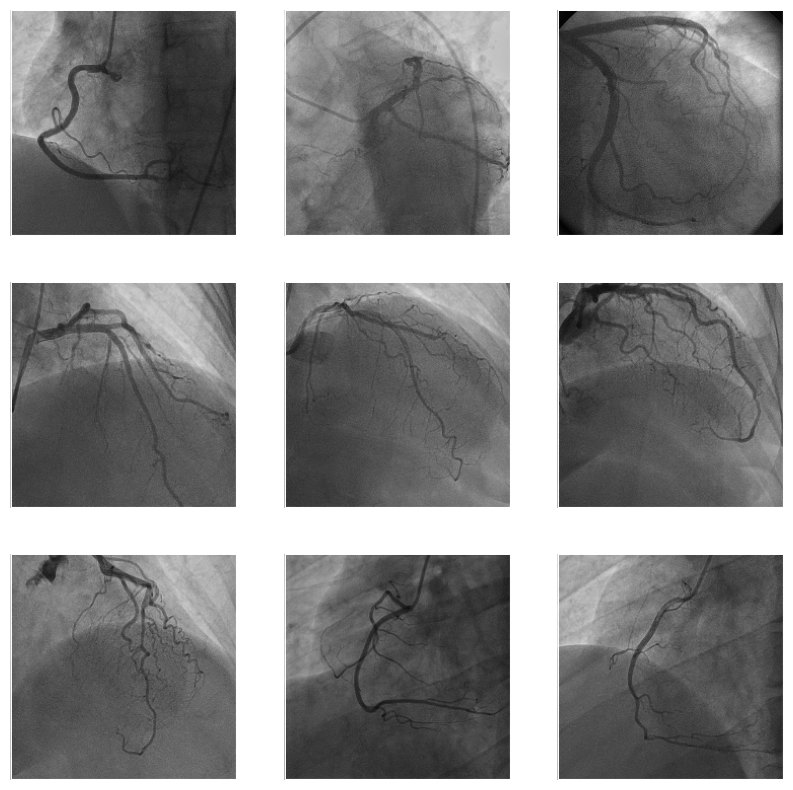

In [35]:
plot_images(image_paths)

In [36]:
num_images = len(image_paths)
print(f"Number of images in the dataset: {num_images}")

Number of images in the dataset: 2156


In [37]:
sample_image_path = image_paths[0]
sample_image = tf.io.read_file(sample_image_path)
sample_image = tf.image.decode_jpeg(sample_image, channels=3)
sample_image = tf.image.resize(sample_image, (224, 224))

print(f"Sample image shape: {sample_image.shape}")

Sample image shape: (224, 224, 3)


In [46]:
def calculate_statistics(image_paths):
    means = []
    stds = []
    for path in image_paths:
        image = tf.io.read_file(path)
        image = tf.image.decode_jpeg(image, channels=3)
        image = tf.image.resize(image, (224, 224)) / 255.0
        means.append(np.mean(image.numpy()))
        stds.append(np.std(image.numpy()))
    
    return np.mean(means), np.std(stds)

mean, std = calculate_statistics(image_paths)
print(f"Mean of pixel values: {mean}")
print(f"Standard deviation of pixel values: {std}")

Mean of pixel values: 0.39458832144737244
Standard deviation of pixel values: 0.025134343653917313


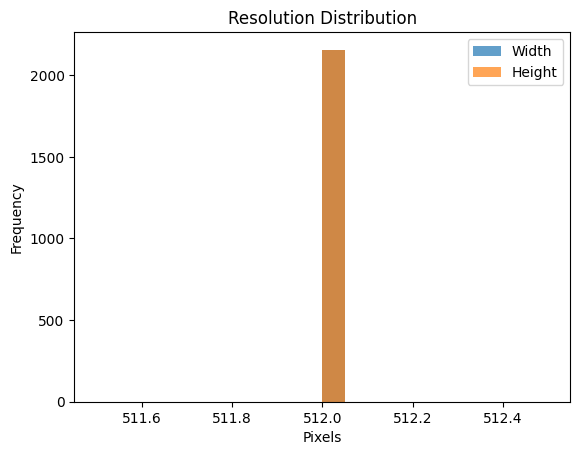

In [47]:
image_resolutions = [tf.image.decode_jpeg(tf.io.read_file(path), channels=3).shape for path in image_paths]
resolutions = np.array(image_resolutions)

plt.hist(resolutions[:, 0], bins=20, alpha=0.7, label='Width')
plt.hist(resolutions[:, 1], bins=20, alpha=0.7, label='Height')
plt.legend()
plt.title('Resolution Distribution')
plt.xlabel('Pixels')
plt.ylabel('Frequency')
plt.show()

First 5 image shapes: [array([512, 512,   3], dtype=int32), array([512, 512,   3], dtype=int32), array([512, 512,   3], dtype=int32), array([512, 512,   3], dtype=int32), array([512, 512,   3], dtype=int32)]


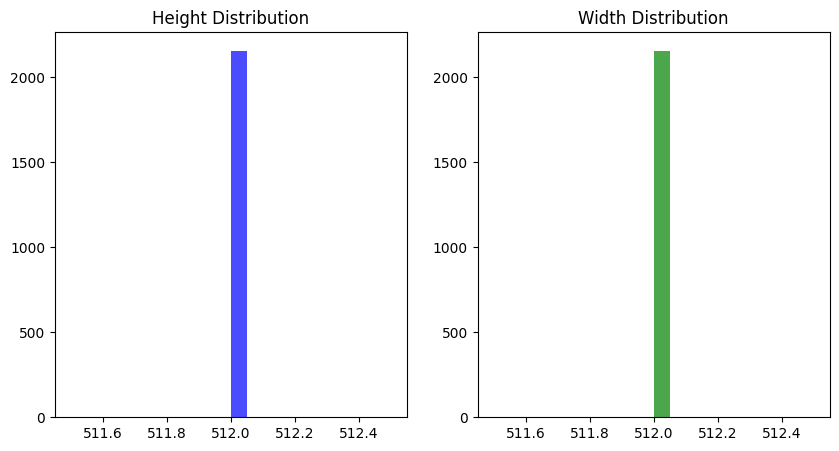

In [48]:
def get_image_shapes(image_paths):
    shapes = []
    for path in image_paths:
        image = tf.io.read_file(path)
        image = tf.image.decode_jpeg(image, channels=3)
        shape = tf.shape(image).numpy()
        shapes.append(shape)
    return shapes

shapes = get_image_shapes(image_paths)

print("First 5 image shapes:", shapes[:5])

heights = [shape[0] for shape in shapes]
widths = [shape[1] for shape in shapes]

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.hist(heights, bins=20, color='blue', alpha=0.7)
plt.title('Height Distribution')

plt.subplot(1, 2, 2)
plt.hist(widths, bins=20, color='green', alpha=0.7)
plt.title('Width Distribution')

plt.show()

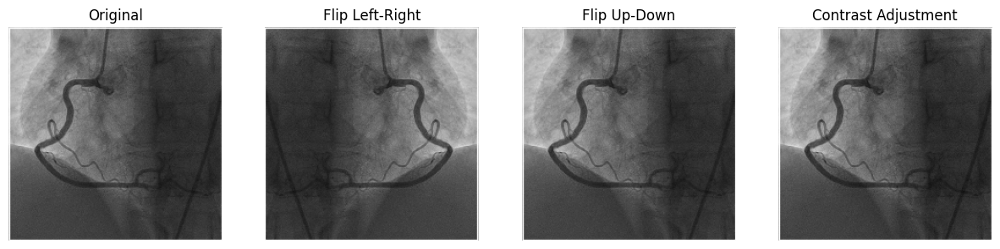

In [51]:
def visualize_augmentations(image):
    augmented_image1 = tf.image.random_flip_left_right(image)
    augmented_image2 = tf.image.random_flip_up_down(image)
    augmented_image3 = tf.image.random_contrast(image, lower=0.8, upper=1.2)

    fig, axes = plt.subplots(1, 4, figsize=(15, 5))
    axes[0].imshow(image)
    axes[0].set_title('Original')
    
    axes[1].imshow(augmented_image1)
    axes[1].set_title('Flip Left-Right')
    
    axes[2].imshow(augmented_image2)
    axes[2].set_title('Flip Up-Down')
    
    axes[3].imshow(augmented_image3)
    axes[3].set_title('Contrast Adjustment')
    
    for ax in axes:
        ax.axis('off')
    
    plt.show()

sample_image = tf.io.read_file(image_paths[0])
sample_image = tf.image.decode_jpeg(sample_image, channels=3)
sample_image = tf.image.resize(sample_image, (224, 224)) / 255.0

visualize_augmentations(sample_image)


In [54]:
def load_annotations(annotation_path):
    with open(annotation_path, 'r') as file:
        annotations = json.load(file)
    return annotations

In [55]:
def load_labels(label_path):
    with open(label_path, 'r') as file:
        labels = file.readlines()
    return [label.strip() for label in labels]

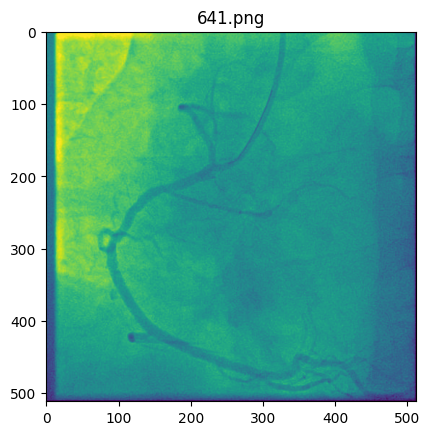

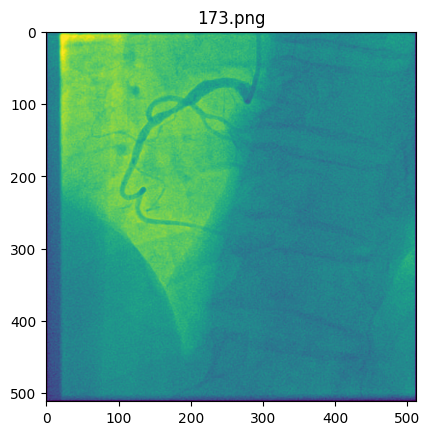

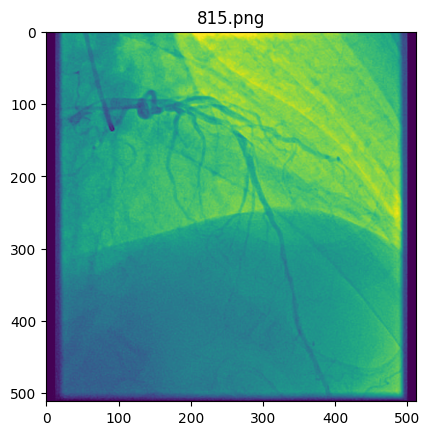

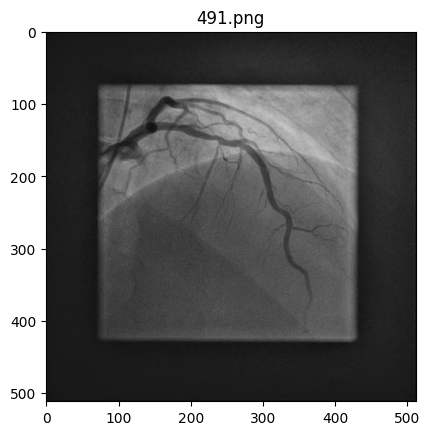

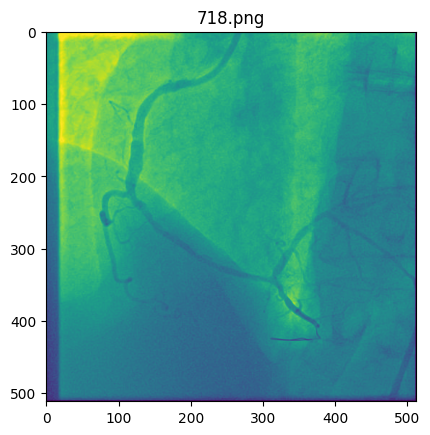

In [74]:
image_dir = '/kaggle/input/arcade-x-ray-angiography-images/submission/stenosis/train/images'
image_files = os.listdir(image_dir)[:5]
for img_file in image_files:
    img = Image.open(os.path.join(image_dir, img_file))
    plt.imshow(img)
    plt.title(img_file)
    plt.show()

In [76]:
from collections import Counter
label_dir = '/kaggle/input/arcade-x-ray-angiography-images/submission/stenosis/train/labels'
label_files = os.listdir(label_dir)
labels = []
for label_file in label_files[:100]:  # Check first 100 labels
    with open(os.path.join(label_dir, label_file), 'r') as f:
        labels.extend(f.readlines())

label_counts = Counter([label.strip() for label in labels])
print(label_counts)


Counter({'25 0.4196875 0.5205078125 0.421875 0.53271484375 0.4269921875 0.54345703125 0.437734375 0.5576171875 0.445078125 0.5673828125 0.4558203125 0.580078125 0.468515625 0.58935546875 0.4870703125 0.599609375 0.501953125 0.60693359375 0.51220703125 0.61279296875 0.52880859375 0.5986328125 0.517578125 0.58935546875 0.50732421875 0.5830078125 0.49609375 0.5751953125 0.4851171875 0.56884765625 0.47412109375 0.56005859375 0.46728515625 0.5517578125 0.4599609375 0.5419921875 0.45458984375 0.53125 0.451171875 0.521484375 0.447265625 0.50732421875': 1, '25 0.294921875 0.2333984375 0.3073828125 0.23962890625 0.3134765625 0.24646484375 0.320546875 0.2551171875 0.326171875 0.2629296875 0.33251953125 0.2722265625 0.339609375 0.281484375 0.34765625 0.29248046875 0.357421875 0.2998046875 0.3664453125 0.30517578125 0.3757421875 0.3134765625 0.3818359375 0.32421875 0.38525390625 0.33544921875 0.39013671875 0.34619140625 0.3935546875 0.35498046875 0.39501953125 0.3679296875 0.42822265625 0.36207031

In [79]:
annotation_file = '/kaggle/input/arcade-x-ray-angiography-images/submission/stenosis/train/annotations/train.json'
with open(annotation_file, 'r') as f:
    annotations = json.load(f)

print(annotations)

{'images': [{'id': 676, 'width': 512, 'height': 512, 'file_name': '676.png', 'license': 0, 'flickr_url': '', 'coco_url': '', 'date_captured': 0}, {'id': 960, 'width': 512, 'height': 512, 'file_name': '960.png', 'license': 0, 'flickr_url': '', 'coco_url': '', 'date_captured': 0}, {'id': 99, 'width': 512, 'height': 512, 'file_name': '99.png', 'license': 0, 'flickr_url': '', 'coco_url': '', 'date_captured': 0}, {'id': 672, 'width': 512, 'height': 512, 'file_name': '672.png', 'license': 0, 'flickr_url': '', 'coco_url': '', 'date_captured': 0}, {'id': 7, 'width': 512, 'height': 512, 'file_name': '7.png', 'license': 0, 'flickr_url': '', 'coco_url': '', 'date_captured': 0}, {'id': 833, 'width': 512, 'height': 512, 'file_name': '833.png', 'license': 0, 'flickr_url': '', 'coco_url': '', 'date_captured': 0}, {'id': 628, 'width': 512, 'height': 512, 'file_name': '628.png', 'license': 0, 'flickr_url': '', 'coco_url': '', 'date_captured': 0}, {'id': 546, 'width': 512, 'height': 512, 'file_name': '5

In [80]:
image_files = set(os.listdir(image_dir))
label_files = set(os.listdir(label_dir))
missing_labels = image_files - label_files
print(f'Missing labels for {len(missing_labels)} images')

Missing labels for 1000 images


In [82]:
label_counts = Counter([label.strip() for label in labels])

label_series = pd.Series(label_counts)

plt.figure(figsize=(10, 6))
sns.barplot(x=label_series.index, y=label_series.values)
plt.title('Class Distribution')
plt.xlabel('Classes')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()